In [ ]:
#clone YOLOv5
!git clone https://github.com/ultralytics/yolov5  # clone repo
%cd yolov5
%pip install -qr requirements.txt # install dependencies
%pip install -q roboflow

import torch
import os
from IPython.display import Image, clear_output  # to display images
from roboflow import Roboflow
print(f"Setup complete. Using torch {torch.__version__} ({torch.cuda.get_device_properties(0).name if torch.cuda.is_available() else 'CPU'})")
rf = Roboflow(api_key="iewnfxMPRApgyBZIcPx2")
project = rf.workspace("yu-twza9").project("sep-788_v1")
dataset = project.version(1).download("yolov5")

Cloning into 'yolov5'...
remote: Enumerating objects: 12202, done.
remote: Total 12202 (delta 0), reused 0 (delta 0), pack-reused 12202
Receiving objects: 100% (12202/12202), 11.44 MiB | 24.93 MiB/s, done.
Resolving deltas: 100% (8479/8479), done.
/content/yolov5/yolov5/yolov5/yolov5
Setup complete. Using torch 1.10.0+cu111 (Tesla K80)
loading Roboflow workspace...
loading Roboflow project...


Extracting Dataset Version Zip to /content/datasets/SEP-788_V1-1 in yolov5pytorch:: 100%|██████████| 2412/2412 [00:03<00:00, 785.37it/s]


In [ ]:
# set up environment
os.environ["DATASET_DIRECTORY"] = "/content/datasets"

In [ ]:
!python train.py --img 640 --batch 32 --epochs 200 --data {dataset.location}/data.yaml --weights yolov5s.pt --cache

train: weights=yolov5s.pt, cfg=, data=/content/datasets/SEP-788_V1-1/data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=200, batch_size=32, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=exp, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v6.1-73-gd51f9b2 torch 1.10.0+cu111 CUDA:0 (Tesla K80, 11441MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, anchor_t=4.0, fl_gamma=0.0, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, degrees=

In [ ]:
# Start tensorboard
# Launch after you have started training
# logs save in the folder "runs"
%load_ext tensorboard
%tensorboard --logdir runs

<IPython.core.display.Javascript object>

In [ ]:
!python detect.py --weights runs/train/exp/weights/best.pt --img 416 --conf 0.1 --source {dataset.location}/test/images

detect: weights=['runs/train/exp/weights/best.pt'], source=/content/datasets/SEP-788_V1-1/test/images, data=data/coco128.yaml, imgsz=[416, 416], conf_thres=0.1, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
YOLOv5 🚀 v6.1-73-gd51f9b2 torch 1.10.0+cu111 CUDA:0 (Tesla K80, 11441MiB)

Fusing layers... 
Model summary: 213 layers, 7018216 parameters, 0 gradients, 15.8 GFLOPs
image 1/120 /content/datasets/SEP-788_V1-1/test/images/0000000000_png.rf.3923f93047527cd10f2ccfec4aa0f074.jpg: 416x416 2 Cars, 1 Truck, Done. (0.028s)
image 2/120 /content/datasets/SEP-788_V1-1/test/images/0000000000_png.rf.78969e21d2f4b7aa40b935259ec68d99.jpg: 416x416 2 Cars, 1 Truck, Done. (0.028s)
image 3/120 /content/datasets/SEP-788_V1-1/test/im

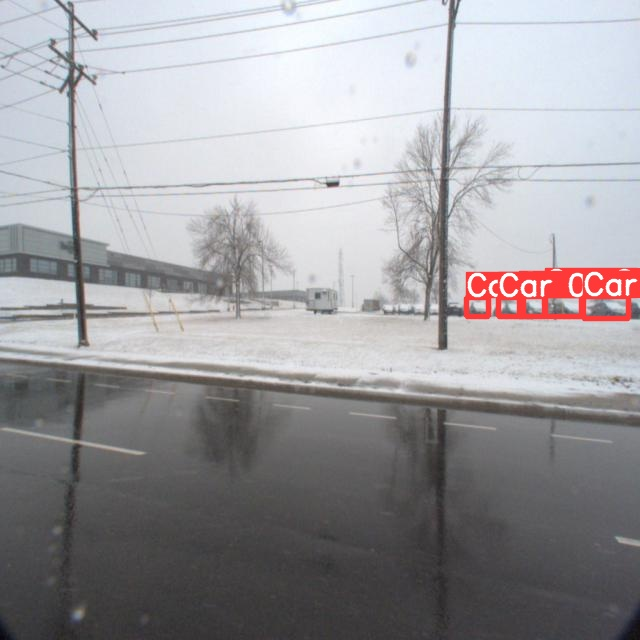

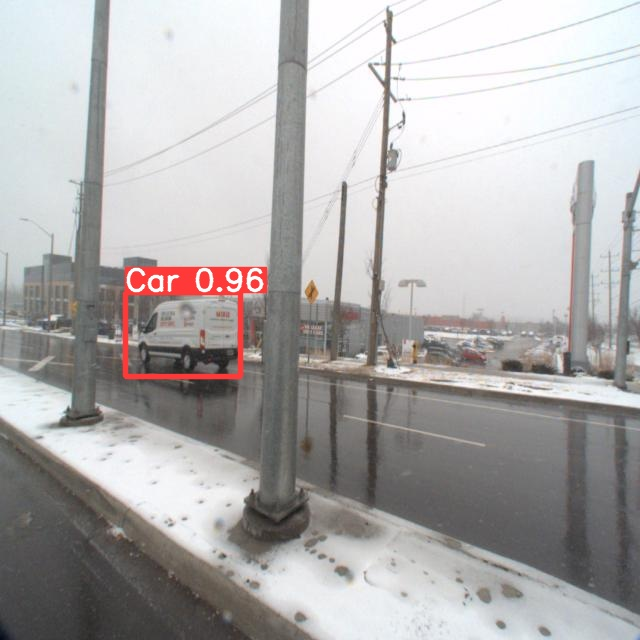

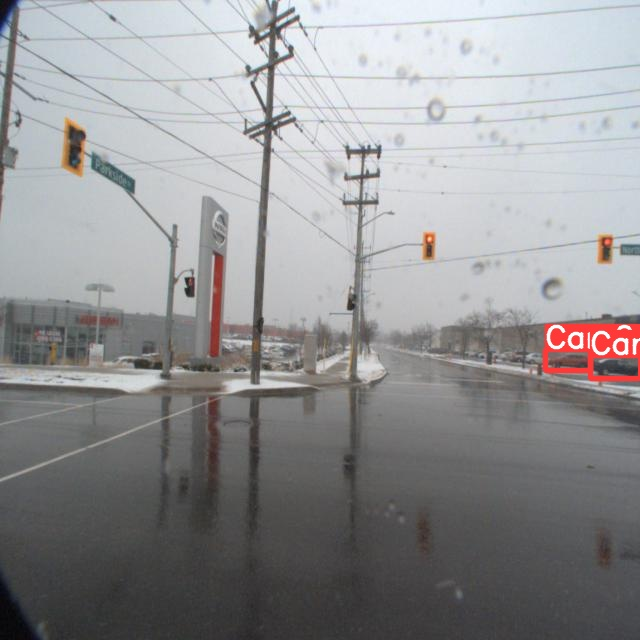

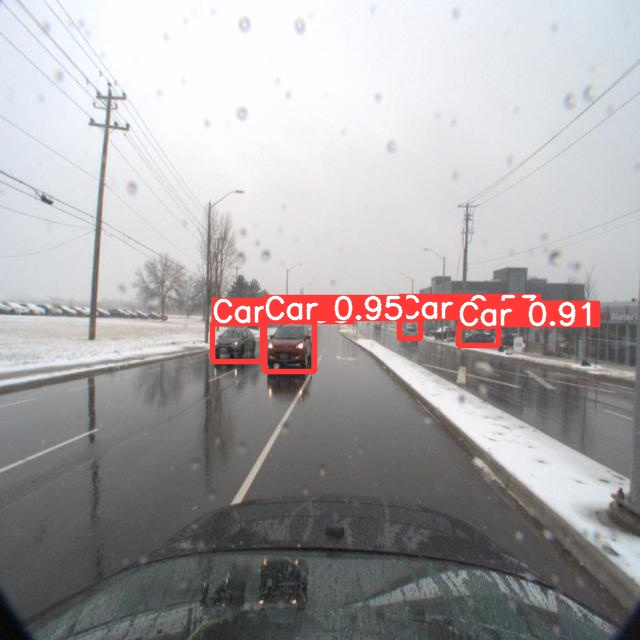

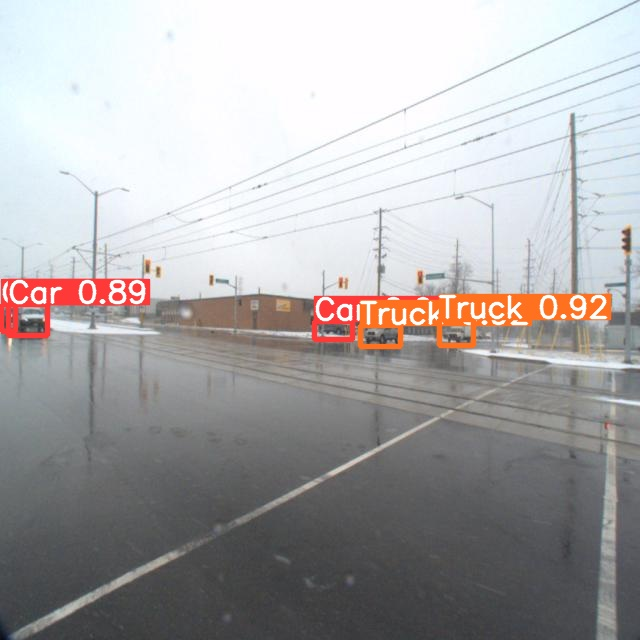

...

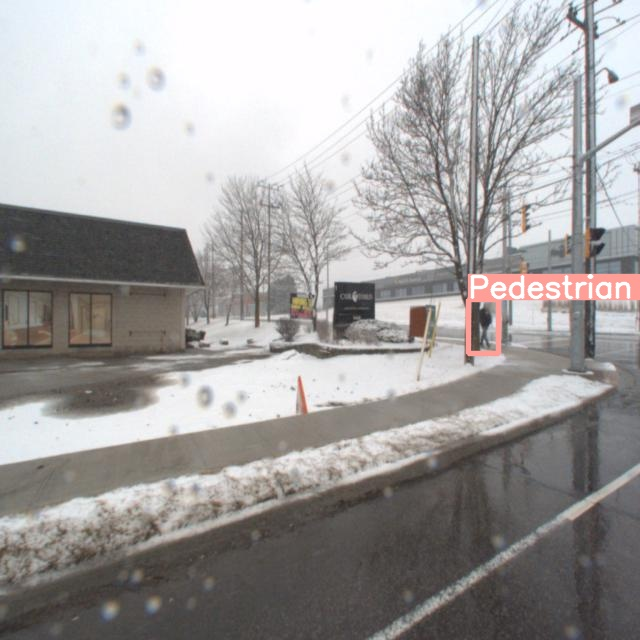

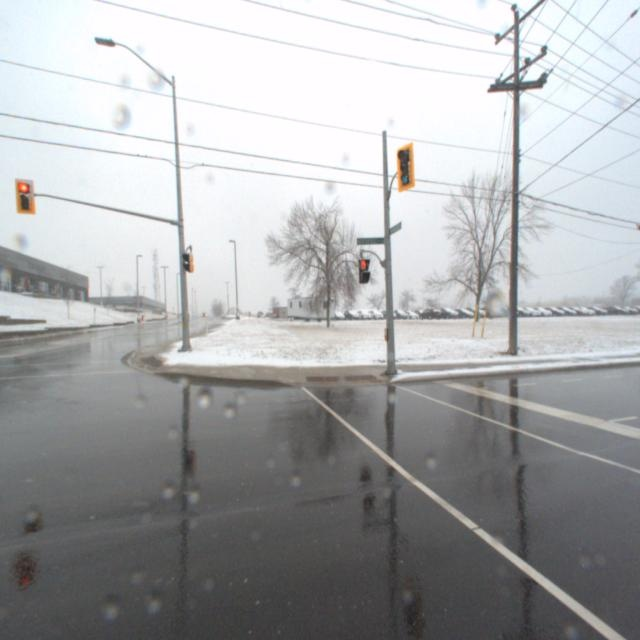

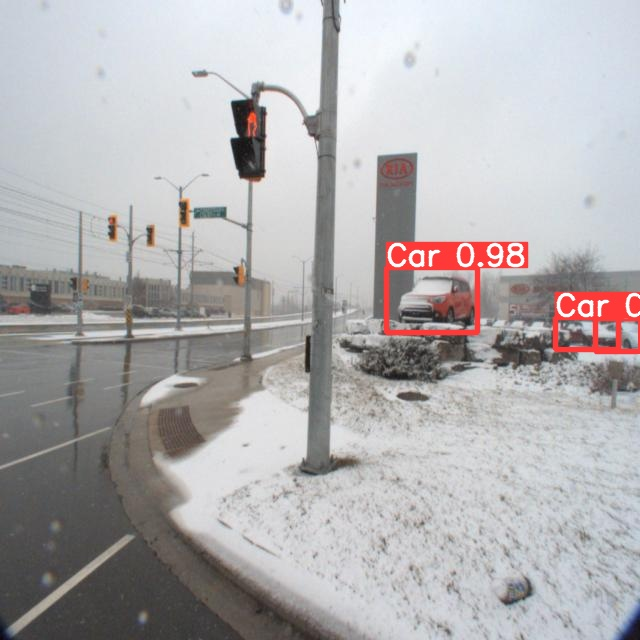

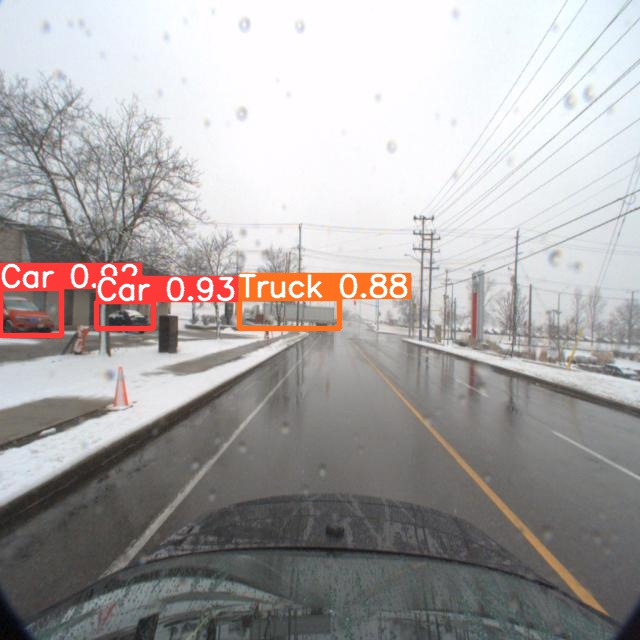

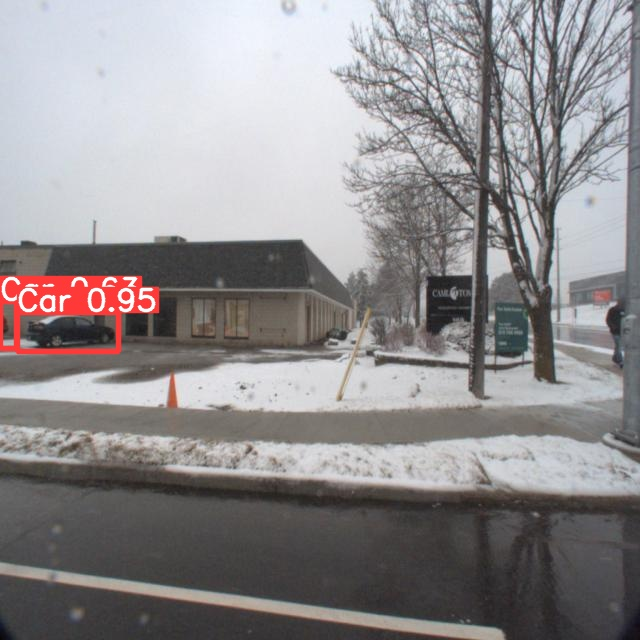

In [ ]:
#display inference on ALL test images

import glob
from IPython.display import Image, display

for imageName in glob.glob('/content/yolov5/yolov5/yolov5/yolov5/runs/detect/exp/*.jpg'): #assuming JPG
    display(Image(filename=imageName))
    print("\n")

In [ ]:
!zip -r /content/file.zip /content/yolov5/yolov5/yolov5/yolov5/runs/detect

  adding: content/yolov5/yolov5/yolov5/yolov5/runs/detect/ (stored 0%)
  adding: content/yolov5/yolov5/yolov5/yolov5/runs/detect/exp/ (stored 0%)
  adding: content/yolov5/yolov5/yolov5/yolov5/runs/detect/exp/0000000007_png.rf.69830f2a1230243b61d2694ce14833f2.jpg (deflated 5%)
  adding: content/yolov5/yolov5/yolov5/yolov5/runs/detect/exp/0000000025_png.rf.aa389b9a42afefc622618d39f414fb4a.jpg (deflated 5%)
  adding: content/yolov5/yolov5/yolov5/yolov5/runs/detect/exp/0000000054_png.rf.6dadc4327988bc2fdf4305d5f3d974f0.jpg (deflated 5%)
  adding: content/yolov5/yolov5/yolov5/yolov5/runs/detect/exp/0000000021_png.rf.c6b4869b27344f7f91452b0c0069c86f.jpg (deflated 4%)
  adding: content/yolov5/yolov5/yolov5/yolov5/runs/detect/exp/0000000021_png.rf.224ac8bec85491aa4a5f47cf691d68f8.jpg (deflated 4%)
  adding: content/yolov5/yolov5/yolov5/yolov5/runs/detect/exp/0000000033_png.rf.b6c8c815713a7c707a429f4ce559d714.jpg (deflated 3%)
  adding: content/yolov5/yolov5/yolov5/yolov5/runs/detect/exp/000000

In [ ]:
from google.colab import files
files.download("/content/file.zip")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>